In [ ]:
!git clone https://github.com/ignacio-ave/ADA-Portafolio.git
!pip -q install PyPDF2 # Importar datos con formato PDF
!pip -q install wordcloud # Graficos con formato nube de palabras
!pip -q install afinn # Diccionario analizar el sentimiento

fatal: destination path 'ADA-Portafolio' already exists and is not an empty directory.


In [ ]:
import re
import PyPDF2

from typing import Dict, List

from wordcloud import WordCloud
import matplotlib.pyplot as plt

import os
import time


In [ ]:

stop_words_es = [
    "a", "al", "algo", "algunas", "algunos", "ante", "antes", "como", "con", "contra", "cual", "cuando",
    "de", "del", "desde", "donde", "durante", "e", "el", "ella", "ellas", "ellos", "en", "entre", "era",
    "erais", "eran", "eras", "eres", "es", "esa", "esas", "ese", "eso", "esos", "esta", "estaba", "estabais",
    "estaban", "estabas", "estad", "estada", "estadas", "estado", "estados", "estamos", "estando", "estar",
    "estaremos", "estará", "estarán", "estarás", "estaré", "estaréis", "estaría", "estaríais", "estaríamos",
    "estarían", "estarías", "estas", "este", "estemos", "esto", "estos", "estoy", "estuve", "estuviera",
    "estuvierais", "estuvieran", "estuvieras", "estuvieron", "estuviese", "estuvieseis", "estuviesen",
    "estuvieses", "estuvimos", "estuviste", "estuvisteis", "estuviéramos", "estuviésemos", "estuvo", "está",
    "estábamos", "estáis", "están", "estás", "esté", "estéis", "estén", "estés", "fue", "fuera", "fuerais",
    "fueran", "fueras", "fueron", "fuese", "fueseis", "fuesen", "fueses", "fui", "fuimos", "fuiste", "fuisteis",
    "fuéramos", "fuésemos", "ha", "habida", "habidas", "habido", "habidos", "habiendo", "habremos", "habrá",
    "habrán", "habrás", "habré", "habréis", "habría", "habríais", "habríamos", "habrían", "habrías", "habéis",
    "había", "habíais", "habíamos", "habían", "habías", "han", "has", "hasta", "hay", "haya", "hayamos", "hayan",
    "hayas", "hayáis", "he", "hemos", "hube", "hubiera", "hubierais", "hubieran", "hubieras", "hubieron",
    "hubiese", "hubieseis", "hubiesen", "hubieses", "hubimos", "hubiste", "hubisteis", "hubiéramos", "hubiésemos",
    "hubo", "la", "las", "le", "les", "lo", "los", "me", "mi", "mis", "mucho", "muchos", "muy", "más", "mí",
    "mía", "mías", "mío", "míos", "nada", "ni", "no", "nos", "nosotras", "nosotros", "nuestra", "nuestras",
    "nuestro", "nuestros", "o", "os", "otra", "otras", "otro", "otros", "para", "pero", "poco", "por", "porque",
    "que", "quien", "quienes", "qué", "se", "sea", "seamos", "sean", "seas", "seremos", "será", "serán", "serás",
    "seré", "seréis", "sería", "seríais", "seríamos", "serían", "serías", "seáis", "sido", "siendo", "sin",
    "sobre", "sois", "somos", "son", "soy", "su", "sus", "suya", "suyas", "suyo", "suyos", "sí", "también",
    "tanto", "te", "tendremos", "tendrá", "tendrán", "tendrás", "tendré", "tendréis", "tendría", "tendríais",
    "tendríamos", "tendrían", "tendrías", "tened", "tenemos", "tenga", "tengamos", "tengan", "tengas",
    "tengo", "tengáis", "tenida", "tenidas", "tenido", "tenidos", "teniendo", "tenéis", "tenía", "teníais",
    "teníamos", "tenían", "tenías", "ti", "tiene", "tienen", "tienes", "todo", "todos", "tu", "tus", "tuve",
    "tuviera", "tuvierais", "tuvieran", "tuvieras", "tuvieron", "tuviese", "tuvieseis", "tuviesen", "tuvieses",
    "tuvimos", "tuviste", "tuvisteis", "tuviéramos", "tuviésemos", "tuvo", "tuya", "tuyas", "tuyo", "tuyos",
    "tú", "un", "una", "uno", "unos", "vosotras", "vosotros", "vuestra", "vuestras", "vuestro", "vuestros",
    "y", "ya", "yo", "él", "éramos" , "que", "los", "para", "las", "con", "por", "del", "una", "más", "este",
    "como", "nos", "también", "esta", "pero", "hemos", "estamos", "eso","mil"
]


In [ ]:

def cargar_texto_pdf(pdf_path: str) -> str:
    with open(pdf_path, 'rb') as file:
        reader = PyPDF2.PdfReader(file)
        texto = []
        for page_num in range(len(reader.pages)):
            texto.append(reader.pages[page_num].extract_text())
    return "\n".join(texto)


In [ ]:

def graficar_ft(ft_result: Dict[str, float], filename):
    # Convertir frecuencias a enteros para mejor visualización
    ft_scaled = {word: int(freq * 10000) for word, freq in ft_result.items()}

    # Si no hay palabras para graficar, regresar sin hacer nada
    if not ft_scaled:
        print(f"No hay palabras suficientes para graficar en el archivo: {filename}")
        return

    # Crear la nube de palabras
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(ft_scaled)

    plt.figure(figsize=(12, 8))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')  # Desactivar los ejes
    plt.title(f'Top palabras por frecuencia {filename}')
    plt.show()




In [ ]:


def tokenizar(text: str) -> List[str]:
    words = re.findall(r'\b\w+\b', text.lower())
    words = [word for word in words if len(word) > 2 and not word.isnumeric() and word not in stop_words_es]
    return words


# (FT)
def calcular_ft(texto: str) -> Dict[str, float]:
    palabras = tokenizar(texto)
    total_palabras = len(palabras)


    cuenta_palabras = {}
    for palabra in palabras:
        if palabra in cuenta_palabras:
            cuenta_palabras[palabra] += 1
        else:
            cuenta_palabras[palabra] = 1

    # Calculate FT
    ft = {}
    for palabra in cuenta_palabras:
        cuenta = cuenta_palabras[palabra]
        frecuencia_termino = cuenta / total_palabras
        ft[palabra] = frecuencia_termino

    return ft

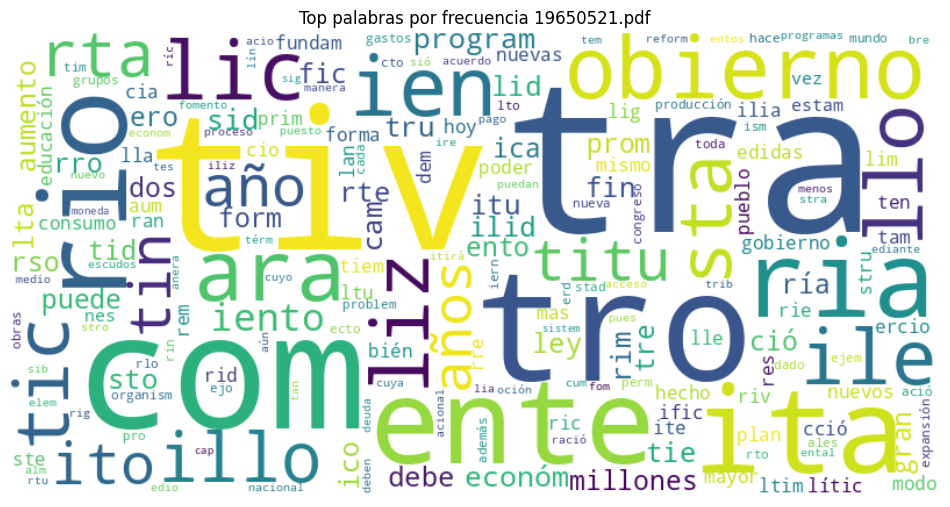

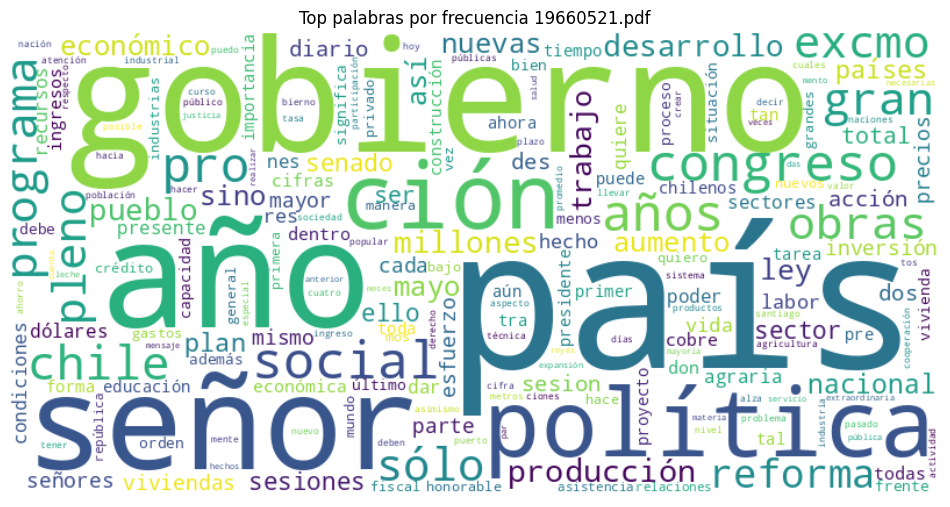

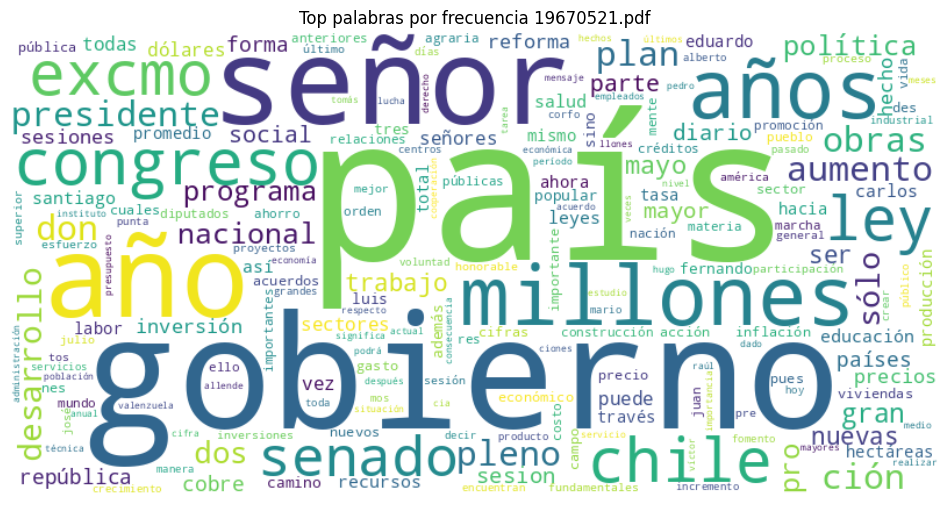

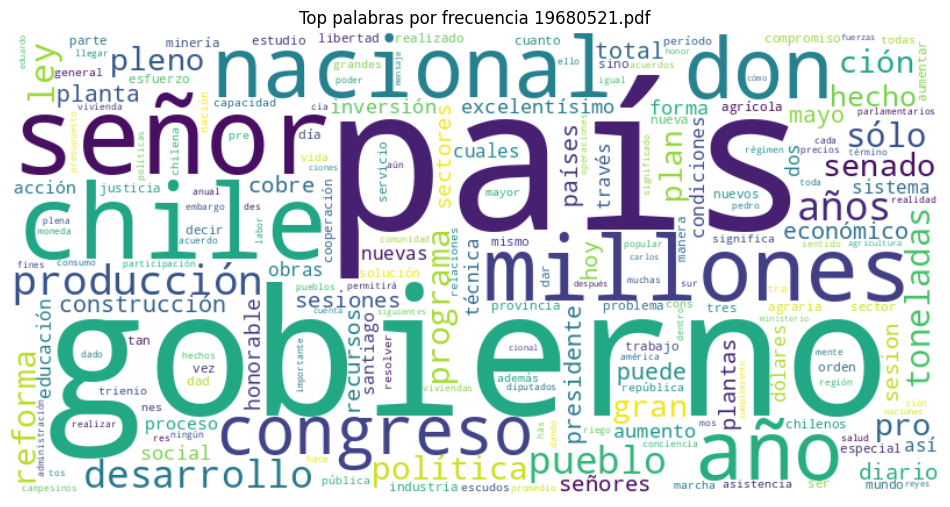

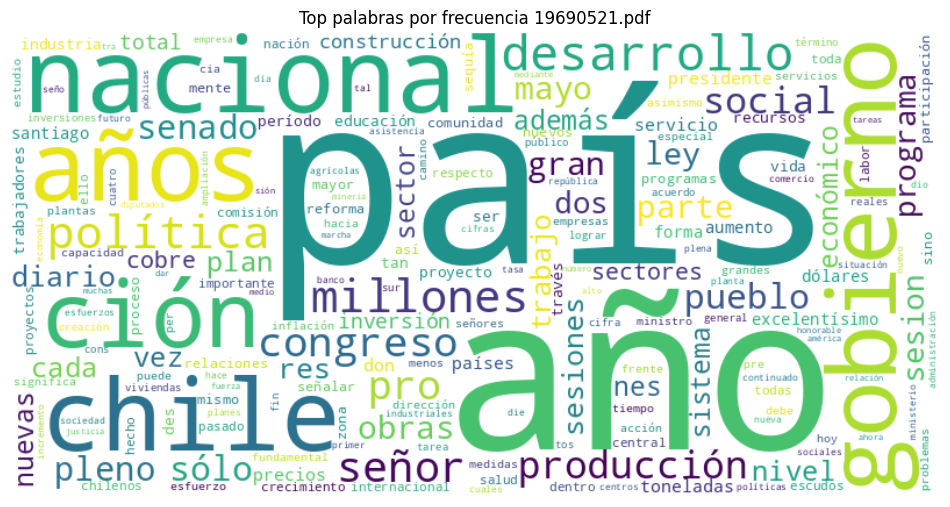

...

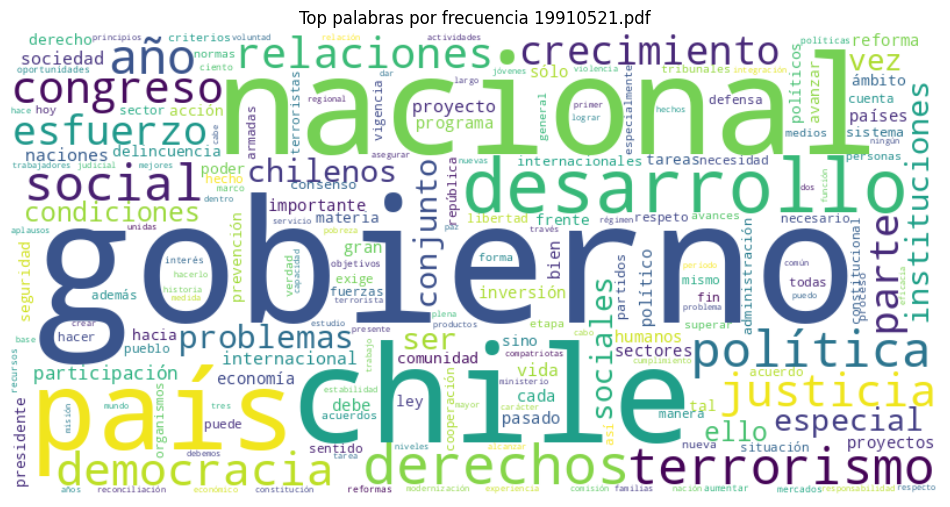

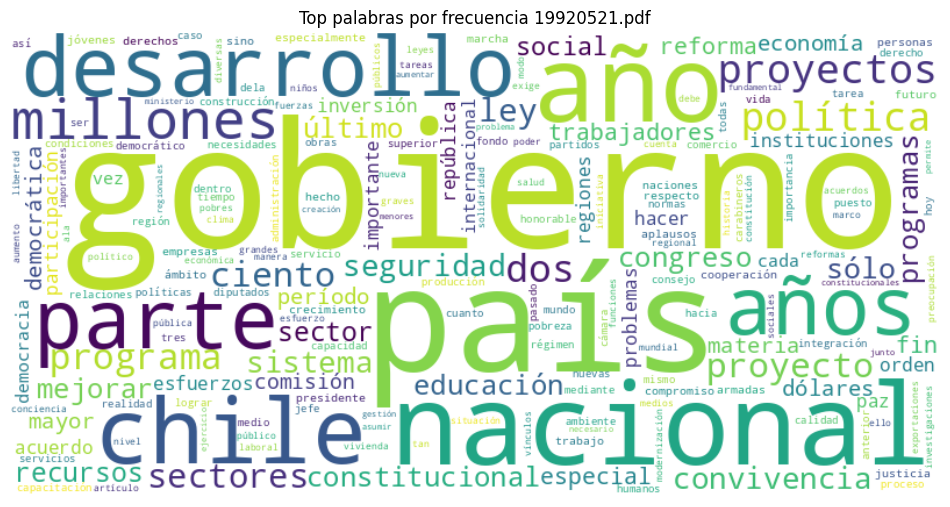

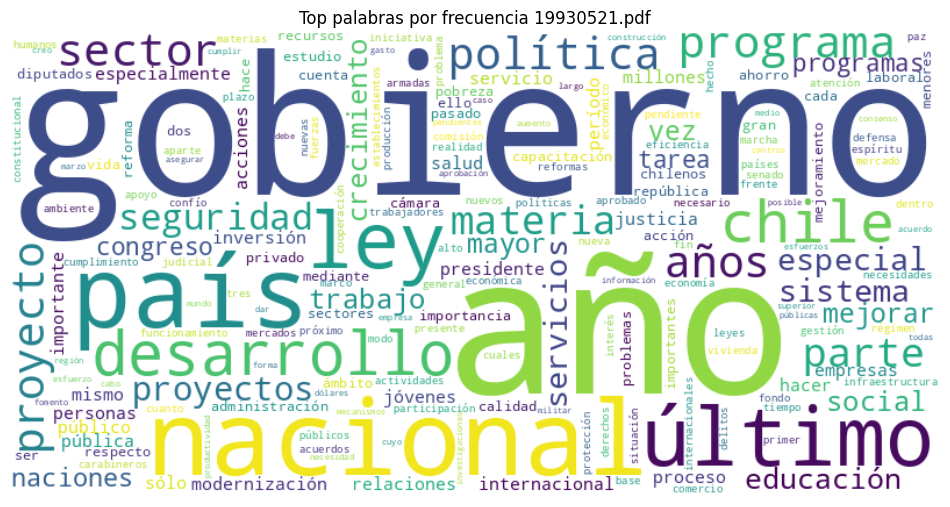

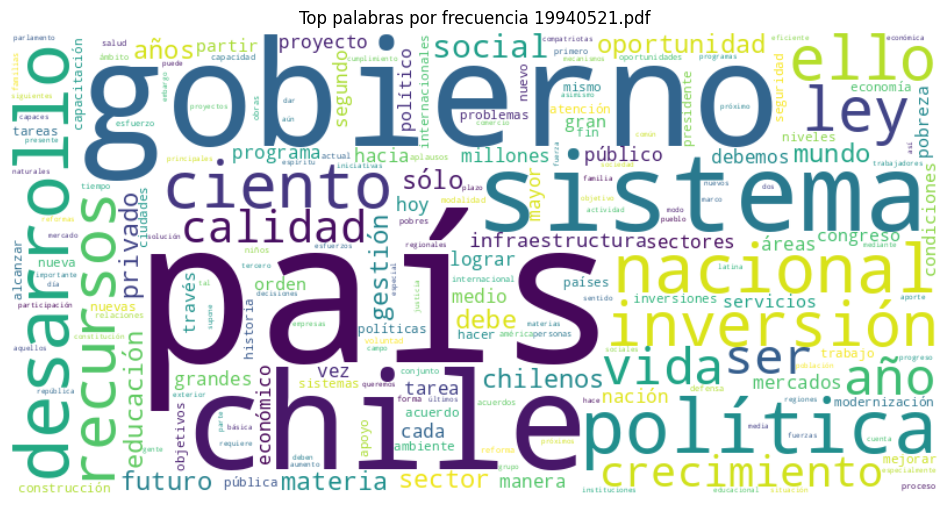

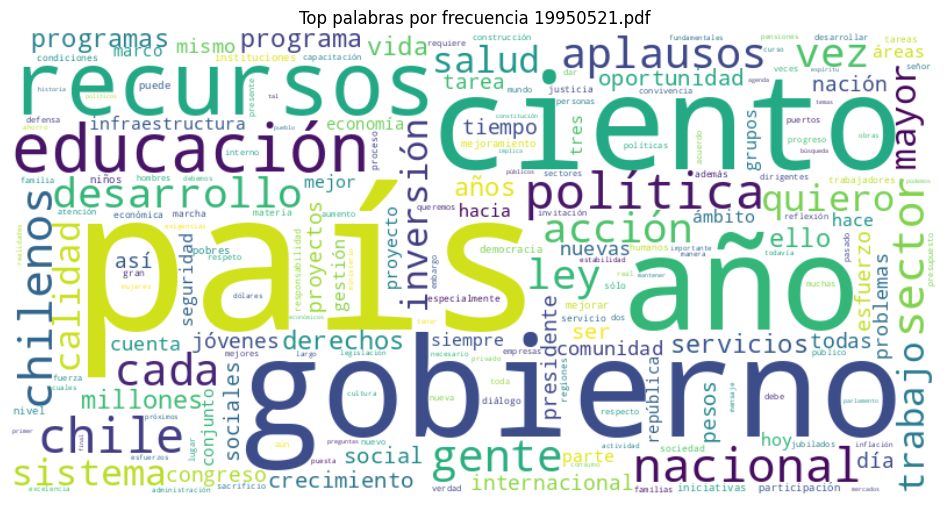

No hay palabras suficientes para graficar en el archivo: 19970521.pdf


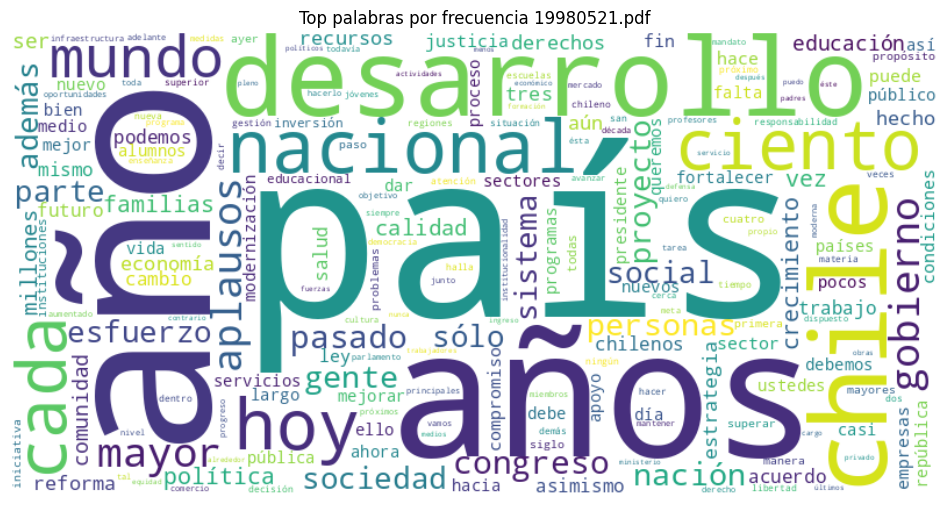

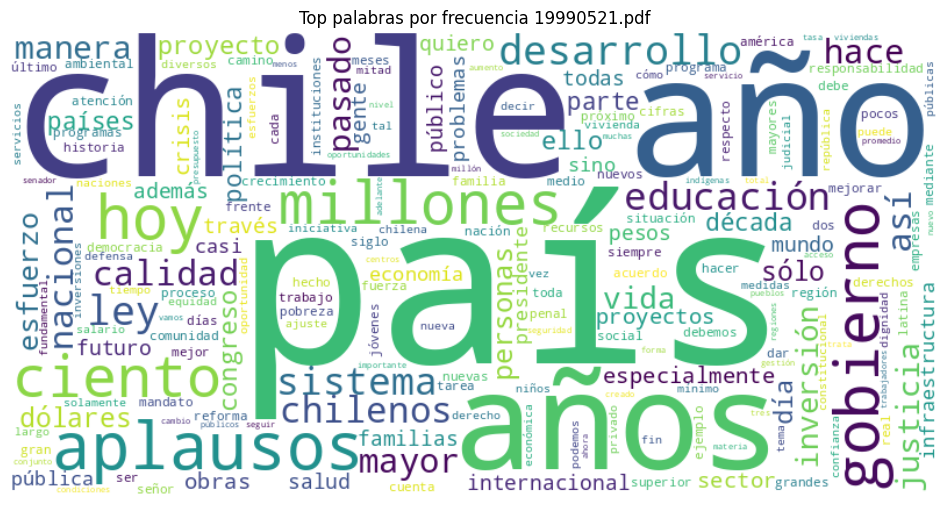

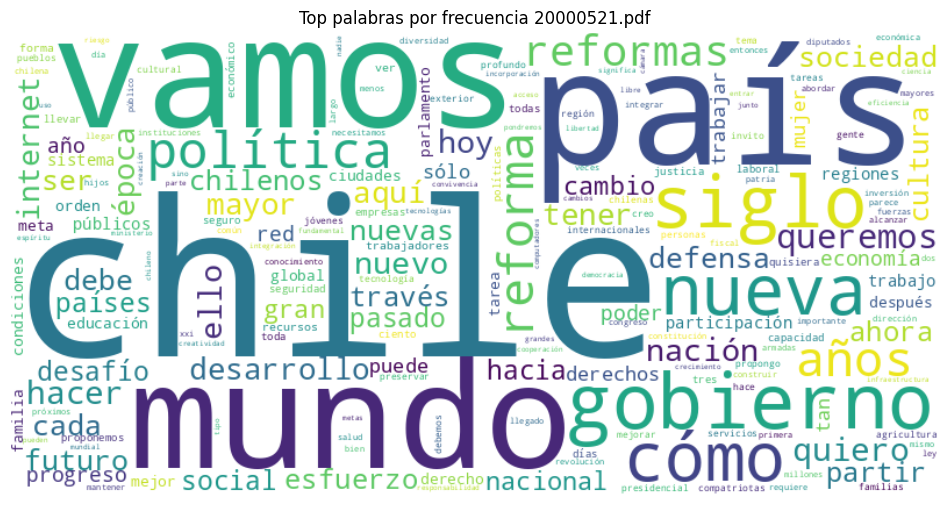

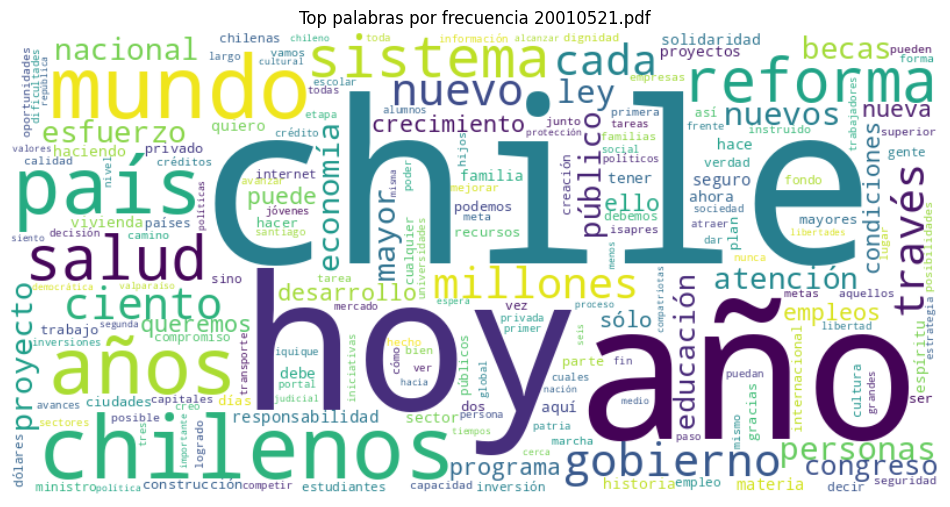

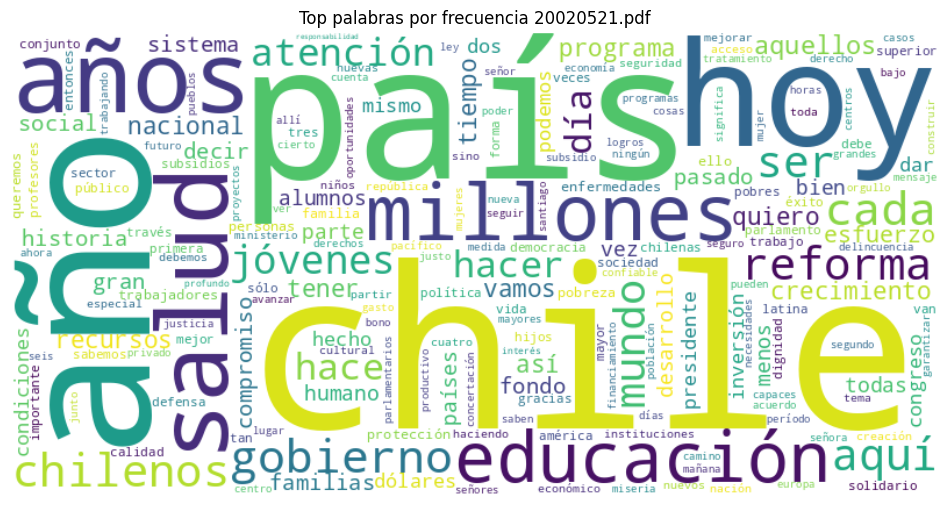

...

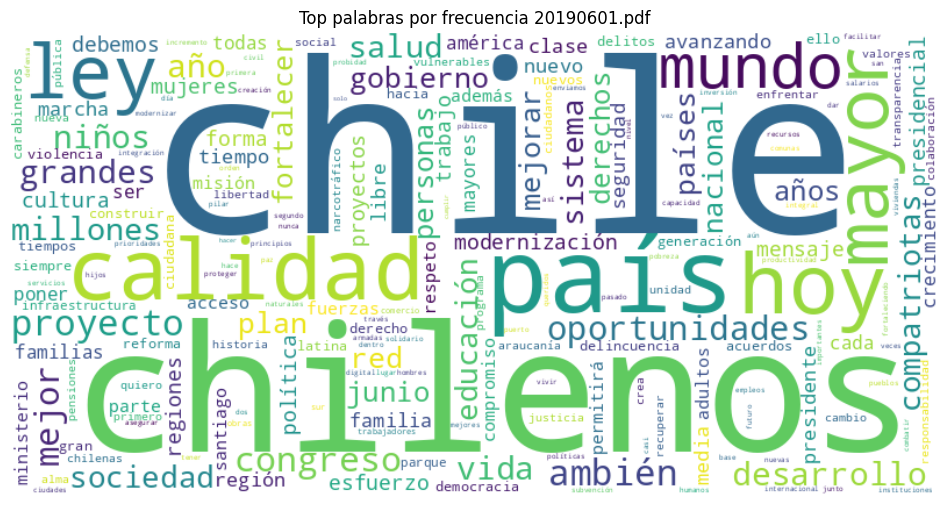

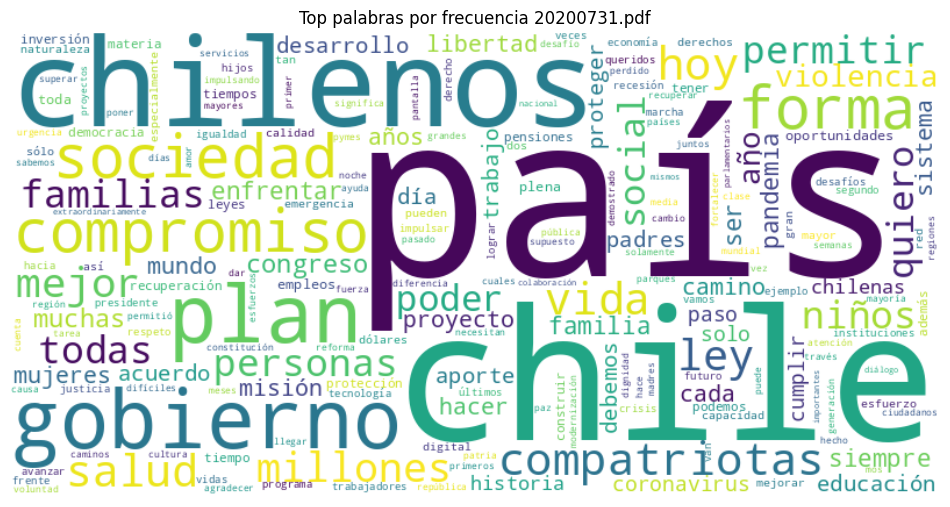

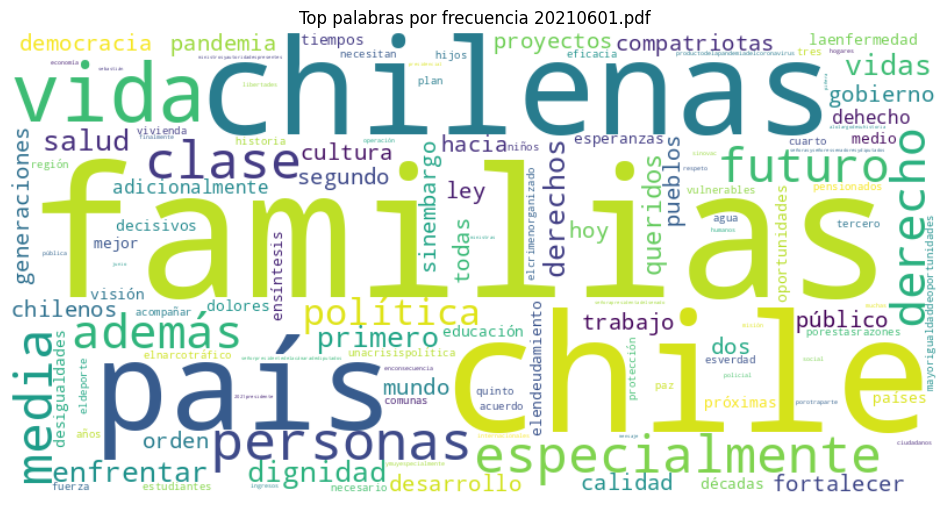

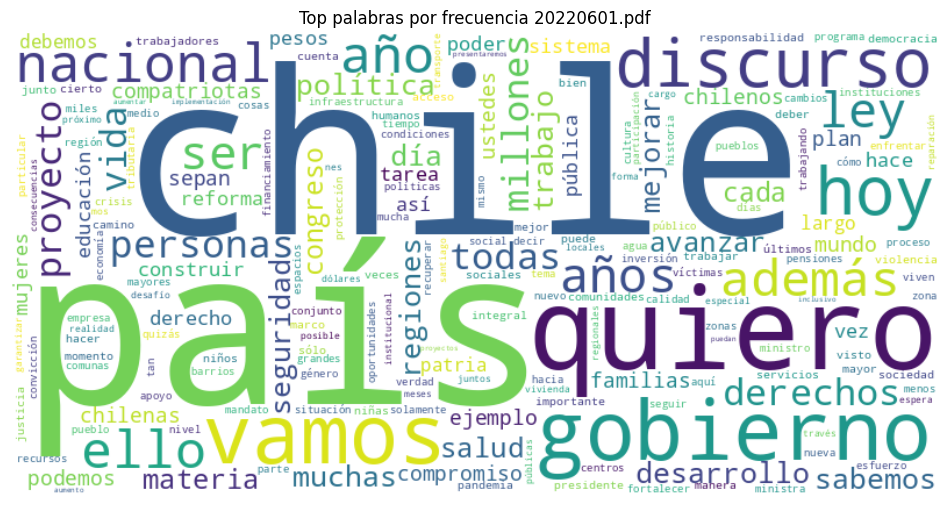

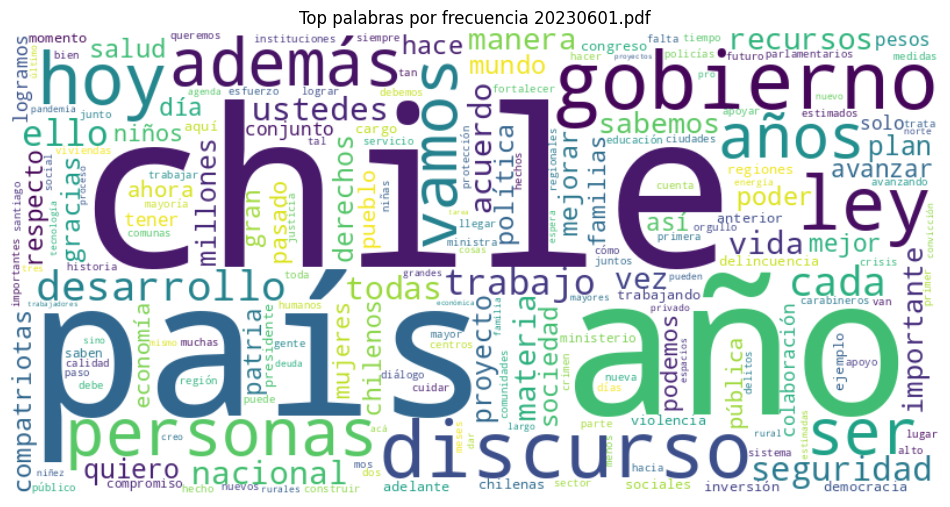

In [ ]:

def analyze_pdf_files_in_directory_ordered(directory_path: str) -> List[Dict[str, any]]:

    analysis_results = []

    sorted_files = sorted([file for file in os.listdir(directory_path) if file.endswith('.pdf')])

    for filename in sorted_files:
        full_path = os.path.join(directory_path, filename)

        start_time = time.time()
        pdf_text = cargar_texto_pdf(full_path)
        total_words = len(tokenizar(pdf_text))

        ft_result = calcular_ft(pdf_text)
        execution_time = time.time() - start_time

        analysis_results.append({
            'filename': filename,
            'total_words': total_words,
            'execution_time': execution_time
        })
        graficar_ft(ft_result, filename)

    return analysis_results

results = analyze_pdf_files_in_directory_ordered("ADA-Portafolio")


In [ ]:
print(results)

[{'filename': '19650521.pdf', 'total_words': 12923, 'execution_time': 14.843874454498291}, {'filename': '19660521.pdf', 'total_words': 13574, 'execution_time': 13.729061841964722}, {'filename': '19670521.pdf', 'total_words': 11286, 'execution_time': 7.04563045501709}, {'filename': '19680521.pdf', 'total_words': 11650, 'execution_time': 2.9917521476745605}, {'filename': '19690521.pdf', 'total_words': 17753, 'execution_time': 14.102600336074829}, {'filename': '19700521.pdf', 'total_words': 15706, 'execution_time': 3.0553789138793945}, {'filename': '19710521.pdf', 'total_words': 4948, 'execution_time': 0.727175235748291}, {'filename': '19720521.pdf', 'total_words': 9357, 'execution_time': 5.182224988937378}, {'filename': '19730521.pdf', 'total_words': 7420, 'execution_time': 2.0346198081970215}, {'filename': '19800911.pdf', 'total_words': 3176, 'execution_time': 0.5921449661254883}, {'filename': '19810911.pdf', 'total_words': 7264, 'execution_time': 0.9734742641448975}, {'filename': '1982

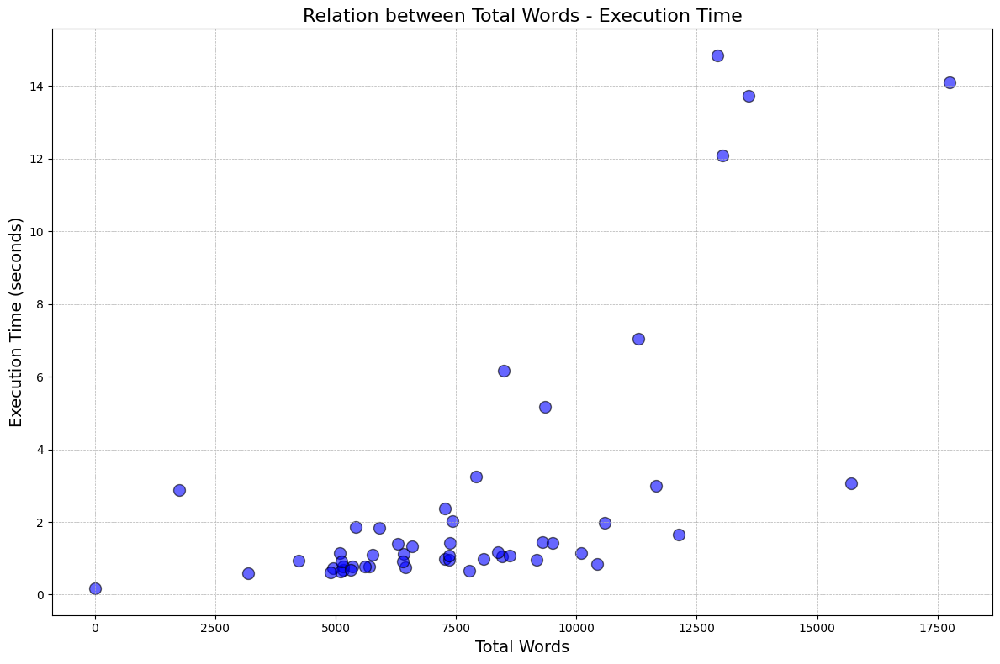

In [ ]:
# Filtro para considerar solo los datos con menos de 20,000 palabras
filtered_words = [word for word in total_words if word <= 20000]
filtered_times = [execution_times[i] for i, word in enumerate(total_words) if word <= 20000]

plt.figure(figsize=(12, 8))
plt.scatter(filtered_words, filtered_times, color='blue', edgecolor='black', s=100, alpha=0.6)
plt.title('Relation between Total Words - Execution Time', fontsize=16)
plt.xlabel('Total Words', fontsize=14)
plt.ylabel('Execution Time (seconds)', fontsize=14)
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()
plt.show()
